<a href="https://colab.research.google.com/github/tassiogomes/Coursera_Capstone/blob/master/BattleOfTheNeighbourhoods.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Read datasets
For the reason that there is a limit to the queries to the Fourquare API (which limited it a lot), the final dataframes were saved in the drive and introduced again.

In [46]:
import pandas as pd

from google.colab import drive 
# Mount your Drive to the Colab VM.
drive.mount('/gdrive')

# Write the DataFrame to CSV file.
crime_2019=pd.read_csv('/gdrive/My Drive/data_science_capstone/crime_2019.csv')
df_top3_crimes=pd.read_csv('/gdrive/My Drive/data_science_capstone/df_top3_crimes.csv')
df_top_venues=pd.read_csv('/gdrive/My Drive/data_science_capstone/df_top_venues.csv')
df_top3_venues=pd.read_csv('/gdrive/My Drive/data_science_capstone/df_top3_venues.csv')
crime_2019c=pd.read_csv('/gdrive/My Drive/data_science_capstone/crime_2019c.csv')
df_features_final_2 =pd.read_csv('/gdrive/My Drive/data_science_capstone/df_features_final_2.csv')
# lat-long of my url bellow
chicago_latitude = 41.916841 
chicago_longitude = -87.593951

Drive already mounted at /gdrive; to attempt to forcibly remount, call drive.mount("/gdrive", force_remount=True).


# Chicago crimes dataset
Due to the level of detail of the available data, the data of the crimes committed in 2019 was chosen to carry out this project.

## Start process

### Import Libraries

In [15]:
import numpy as np # library to handle data in a vectorized manner

import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

import json # library to handle JSON files
import requests

#!conda install -c conda-forge geopy --yes # uncomment this line if you haven't completed the Foursquare API lab
from geopy.geocoders import Nominatim # convert an address into latitude and longitude values

import requests # library to handle requests
from pandas.io.json import json_normalize # tranform JSON file into a pandas dataframe

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# import k-means from clustering stage
from sklearn.cluster import KMeans

#!conda install -c conda-forge folium=0.5.0 --yes # uncomment this line if you haven't completed the Foursquare API lab
import folium # map rendering library

print('Libraries imported.')

Libraries imported.


### Download the dataset

In [48]:
!wget -q -O 'crimes_2019' https://data.cityofchicago.org/api/views/w98m-zvie/rows.csv?accessType=DOWNLOAD&api_foundry=true
print('Data downloaded!')

Data downloaded!


### Explore dataset and creat dataframe (**original_crimes**)

In [49]:
original_crimes = pd.read_csv('crimes_2019', dtype=str)
original_crimes.head()

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,Beat,District,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,11653516,JC222395,04/12/2019 07:15:00 AM,085XX S INGLESIDE AVE,0266,CRIMINAL SEXUAL ASSAULT,PREDATORY,SCHOOL - PUBLIC BUILDING,false,false,0632,006,8,44,02,1184042,1848646,2019,04/12/2020 03:46:59 PM,41.739860331,-87.601274245,"(41.739860331, -87.601274245)"
1,11633627,JC198380,03/23/2019 08:30:00 AM,093XX S SANGAMON ST,1752,OFFENSE INVOLVING CHILDREN,AGGRAVATED CRIMINAL SEXUAL ABUSE BY FAMILY MEMBER,RESIDENCE,false,true,2223,022,21,73,17,1171628,1842756,2019,04/12/2020 03:46:59 PM,41.72397813,-87.646929306,"(41.72397813, -87.646929306)"
2,11615485,JC176179,03/06/2019 12:40:00 PM,064XX S WHIPPLE ST,0266,CRIMINAL SEXUAL ASSAULT,PREDATORY,RESIDENCE,true,true,0823,008,17,66,02,1157161,1861685,2019,04/12/2020 03:46:59 PM,41.776226663,-87.699410789,"(41.776226663, -87.699410789)"
3,11577031,JC128860,01/25/2019 03:00:00 AM,101XX S LAFAYETTE AVE,0266,CRIMINAL SEXUAL ASSAULT,PREDATORY,RESIDENCE,true,true,0511,005,9,49,02,1177711,1837787,2019,04/12/2020 03:46:59 PM,41.71020727,-87.624797434,"(41.71020727, -87.624797434)"
4,11766079,JC358783,07/21/2019 07:20:00 PM,022XX N LONG AVE,041A,BATTERY,AGGRAVATED - HANDGUN,RESIDENCE - PORCH / HALLWAY,false,false,2515,025,36,19,04B,1140015,1914457,2019,04/11/2020 03:46:35 PM,41.921370264,-87.760978493,"(41.921370264, -87.760978493)"


In [50]:
original_crimes.shape

(258946, 22)

In [51]:
original_crimes.isna().sum()

ID                         0
Case Number                0
Date                       0
Block                      0
IUCR                       0
Primary Type               0
Description                0
Location Description    1037
Arrest                     0
Domestic                   0
Beat                       0
District                   0
Ward                      15
Community Area             4
FBI Code                   0
X Coordinate            1147
Y Coordinate            1147
Year                       0
Updated On                 0
Latitude                1147
Longitude               1147
Location                1147
dtype: int64

In [52]:
original_crimes.dtypes

ID                      object
Case Number             object
Date                    object
Block                   object
IUCR                    object
Primary Type            object
Description             object
Location Description    object
Arrest                  object
Domestic                object
Beat                    object
District                object
Ward                    object
Community Area          object
FBI Code                object
X Coordinate            object
Y Coordinate            object
Year                    object
Updated On              object
Latitude                object
Longitude               object
Location                object
dtype: object

### Create a new dataframe with pertinent columns (**crime_2019**)

In [0]:
crime_keep_columns = ['Case Number',
                      'Date',
                      'Block',
                      'Primary Type',
                      'Ward',
                      'Latitude',
                      'Longitude']

In [54]:
crime_2019 = pd.read_csv('crimes_2019',
                 usecols=crime_keep_columns)
crime_2019.head()

,Case Number,Date,Block,Primary Type,Ward,Latitude,Longitude
0,JC222395,04/12/2019 07:15:00 AM,085XX S INGLESIDE AVE,CRIMINAL SEXUAL ASSAULT,8.0,41.739860,-87.601274
1,JC198380,03/23/2019 08:30:00 AM,093XX S SANGAMON ST,OFFENSE INVOLVING CHILDREN,21.0,41.723978,-87.646929
2,JC176179,03/06/2019 12:40:00 PM,064XX S WHIPPLE ST,CRIMINAL SEXUAL ASSAULT,17.0,41.776227,-87.699411
3,JC128860,01/25/2019 03:00:00 AM,101XX S LAFAYETTE AVE,CRIMINAL SEXUAL ASSAULT,9.0,41.710207,-87.624797
4,JC358783,07/21/2019 07:20:00 PM,022XX N LONG AVE,BATTERY,36.0,41.921370,-87.760978


In [55]:
crime_2019.dtypes

Case Number      object
Date             object
Block            object
Primary Type     object
Ward            float64
Latitude        float64
Longitude       float64
dtype: object

## Clean up the data and prepare

### Some modifications

In [0]:
# Strip leading & trailing whitespace
crime_2019.columns = crime_2019.columns.str.strip()

# Replace multiple spaces with a single space
crime_2019.columns = crime_2019.columns.str.replace('\s{2,}', ' ')

# Replace with blank
crime_2019.columns = crime_2019.columns.str.replace('#', '')

# Replace spaces with _
crime_2019.columns = crime_2019.columns.str.replace(' ', '_')

# Convert to lowercase
crime_2019.columns = crime_2019.columns.str.lower()

In [57]:
crime_2019.dtypes

case_number      object
date             object
block            object
primary_type     object
ward            float64
latitude        float64
longitude       float64
dtype: object

In [0]:
crime_2019['date'] = pd.to_datetime(crime_2019['date'], format='%m/%d/%Y %I:%M:%S %p')

In [59]:
# Add new columns to the dataframe to allow hourly, daily & monthly analysis
crime_2019['hour'] = crime_2019['date'].dt.hour
crime_2019['day_name'] = crime_2019['date'].dt.day_name()
crime_2019['day'] = crime_2019['date'].dt.dayofweek + 1
crime_2019['month_name'] = crime_2019['date'].dt.month_name()
crime_2019['month'] = crime_2019['date'].dt.month
crime_2019['year'] = crime_2019['date'].dt.year
crime_2019['year_month'] = crime_2019['date'].dt.to_period('M')

# Add the zip and street attributes
crime_2019['zip'] = crime_2019.block.str.split(' ').str[0]
crime_2019['street'] = crime_2019.block.str.split(' ').str[1:].apply(', '.join)

crime_2019.head()

,case_number,date,block,primary_type,ward,latitude,longitude,hour,day_name,day,month_name,month,year,year_month,zip,street
0,JC222395,2019-04-12 07:15:00,085XX S INGLESIDE AVE,CRIMINAL SEXUAL ASSAULT,8.0,41.739860,-87.601274,7,Friday,5,April,4,2019,2019-04,085XX,"S, INGLESIDE, AVE"
1,JC198380,2019-03-23 08:30:00,093XX S SANGAMON ST,OFFENSE INVOLVING CHILDREN,21.0,41.723978,-87.646929,8,Saturday,6,March,3,2019,2019-03,093XX,"S, SANGAMON, ST"
2,JC176179,2019-03-06 12:40:00,064XX S WHIPPLE ST,CRIMINAL SEXUAL ASSAULT,17.0,41.776227,-87.699411,12,Wednesday,3,March,3,2019,2019-03,064XX,"S, WHIPPLE, ST"
3,JC128860,2019-01-25 03:00:00,101XX S LAFAYETTE AVE,CRIMINAL SEXUAL ASSAULT,9.0,41.710207,-87.624797,3,Friday,5,January,1,2019,2019-01,101XX,"S, LAFAYETTE, AVE"
4,JC358783,2019-07-21 19:20:00,022XX N LONG AVE,BATTERY,36.0,41.921370,-87.760978,19,Sunday,7,July,7,2019,2019-07,022XX,"N, LONG, AVE"


In [60]:
crime_2019.isna().sum()

case_number        0
date               0
block              0
primary_type       0
ward              15
latitude        1147
longitude       1147
hour               0
day_name           0
day                0
month_name         0
month              0
year               0
year_month         0
zip                0
street             0
dtype: int64

In [0]:
# Drop missing values
crime_2019.dropna(inplace=True)

# Redefine index
crime_2019.reset_index(inplace=True)

In [62]:
# check df again~
crime_2019.head()

,index,case_number,date,block,primary_type,ward,latitude,longitude,hour,day_name,day,month_name,month,year,year_month,zip,street
0,0,JC222395,2019-04-12 07:15:00,085XX S INGLESIDE AVE,CRIMINAL SEXUAL ASSAULT,8.0,41.739860,-87.601274,7,Friday,5,April,4,2019,2019-04,085XX,"S, INGLESIDE, AVE"
1,1,JC198380,2019-03-23 08:30:00,093XX S SANGAMON ST,OFFENSE INVOLVING CHILDREN,21.0,41.723978,-87.646929,8,Saturday,6,March,3,2019,2019-03,093XX,"S, SANGAMON, ST"
2,2,JC176179,2019-03-06 12:40:00,064XX S WHIPPLE ST,CRIMINAL SEXUAL ASSAULT,17.0,41.776227,-87.699411,12,Wednesday,3,March,3,2019,2019-03,064XX,"S, WHIPPLE, ST"
3,3,JC128860,2019-01-25 03:00:00,101XX S LAFAYETTE AVE,CRIMINAL SEXUAL ASSAULT,9.0,41.710207,-87.624797,3,Friday,5,January,1,2019,2019-01,101XX,"S, LAFAYETTE, AVE"
4,4,JC358783,2019-07-21 19:20:00,022XX N LONG AVE,BATTERY,36.0,41.921370,-87.760978,19,Sunday,7,July,7,2019,2019-07,022XX,"N, LONG, AVE"


In [63]:
crime_2019.isna().sum()

index           0
case_number     0
date            0
block           0
primary_type    0
ward            0
latitude        0
longitude       0
hour            0
day_name        0
day             0
month_name      0
month           0
year            0
year_month      0
zip             0
street          0
dtype: int64

In [64]:
crime_2019.shape

(257784, 17)

In [0]:
# Import Drive API and authenticate.
from google.colab import drive

# Mount your Drive
drive.mount('/gdrive')

# Write the DataFrame to CSV file.
with open('/gdrive/My Drive/data_science_capstone/crime_2019.csv', 'w') as f:
  crime_2019.to_csv(f)

## Crimes visualization **(descriptive statistics)**

### Libraries

In [0]:
# Import Pandas
import pandas as pd

# Use the inline backend to generate the plots within the browser
%matplotlib inline 

import matplotlib as mpl
import matplotlib.pyplot as plt

import seaborn as sns
sns.set_style("darkgrid")

font = {'size'   : 14}
mpl.rc('font', **font)

# Use Folium to display the Maps for Visualisation
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
from folium import plugins

### Graphs

Text(0.0, 1.0, 'Count of Cases Per Month')

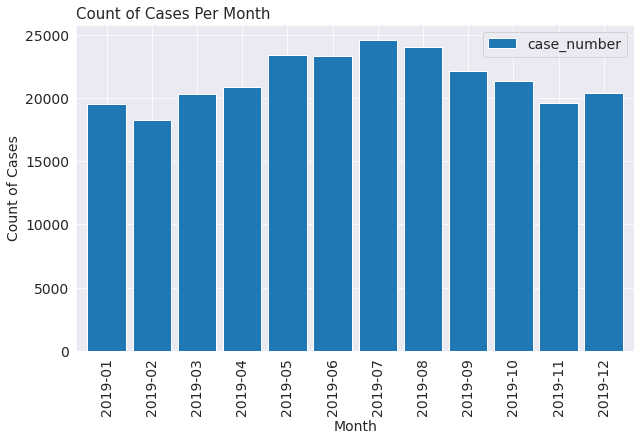

In [232]:
# Group the Crimes per month and produce a bar chart
crime_2019.groupby('year_month').count().plot(y = 'case_number', 
                                             kind='bar',
                                             figsize=(10,6),
                                             width=0.85,
                                             colormap='tab20')

plt.xlabel('Month')
plt.ylabel('Count of Cases')
plt.title('Count of Cases Per Month', loc='left', fontsize=15)

Text(0.0, 1.0, 'Count of Cases Per day of week [1 = sunday]')

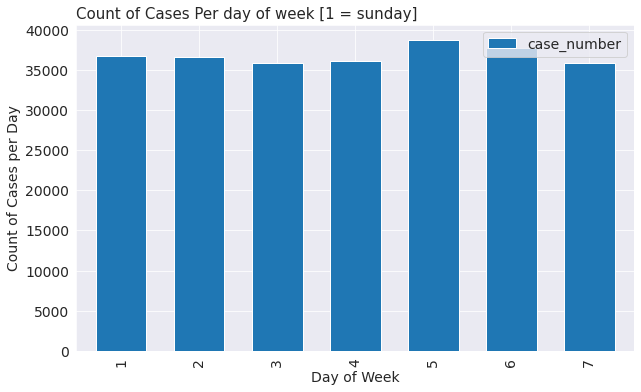

In [233]:
# Crimes per week day
crime_2019.groupby('day').count().plot(y = 'case_number', 
                                             kind='bar',
                                             figsize=(10,6),
                                             width=0.65,
                                             colormap='tab20')

plt.xlabel('Day of Week')
plt.ylabel('Count of Cases per Day')
plt.title('Count of Cases Per day of week [1 = sunday]', loc='left', fontsize=15)

Text(0.0, 1.0, 'Count of Cases Per Hour]')

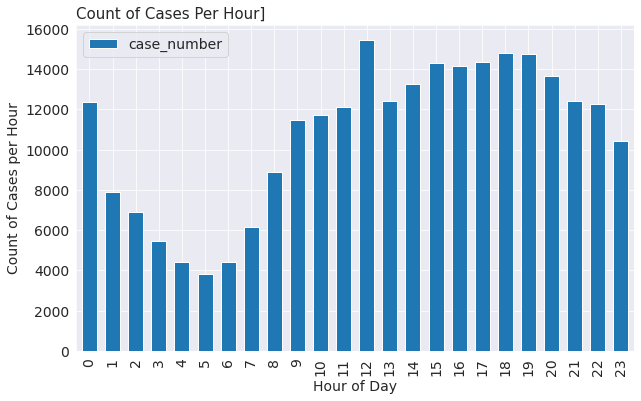

In [234]:
# Crimes per week day
crime_2019.groupby('hour').count().plot(y = 'case_number', 
                                             kind='bar',
                                             figsize=(10,6),
                                             width=0.65,
                                             colormap='tab20')

plt.xlabel('Hour of Day')
plt.ylabel('Count of Cases per Hour')
plt.title('Count of Cases Per Hour]', loc='left', fontsize=15)

In [235]:
# Crimes are the 3 most commonly occuring ones 
crime_2019[['primary_type', 'case_number']].groupby(
    ['primary_type'], as_index=False).count().sort_values(
    'case_number', ascending=False).head(3)

,primary_type,case_number
30,THEFT,61612
2,BATTERY,49460
6,CRIMINAL DAMAGE,26597


In [236]:
# Create a list of the 3 most commonly occuring crimes
top_three_crimes = crime_2019[['primary_type', 'case_number']].groupby(
    ['primary_type']).count().sort_values('case_number', ascending=False)[:3].axes[0].tolist()

top_three_crimes

['THEFT', 'BATTERY', 'CRIMINAL DAMAGE']

In [0]:
# Create a new data frame with just the top 3 crimes
df_top3_crimes = crime_2019[crime_2019['primary_type'].isin(top_three_crimes)].copy()

In [0]:
# Import Drive API and authenticate.
from google.colab import drive

# Mount your Drive
drive.mount('/gdrive')

# Write the DataFrame to CSV file.
with open('/gdrive/My Drive/data_science_capstone/df_top3_crimes.csv', 'w') as f:
  df_top3_crimes.to_csv(f)

Text(0.0, 1.0, 'Count of Top 3 Cases Per Month')

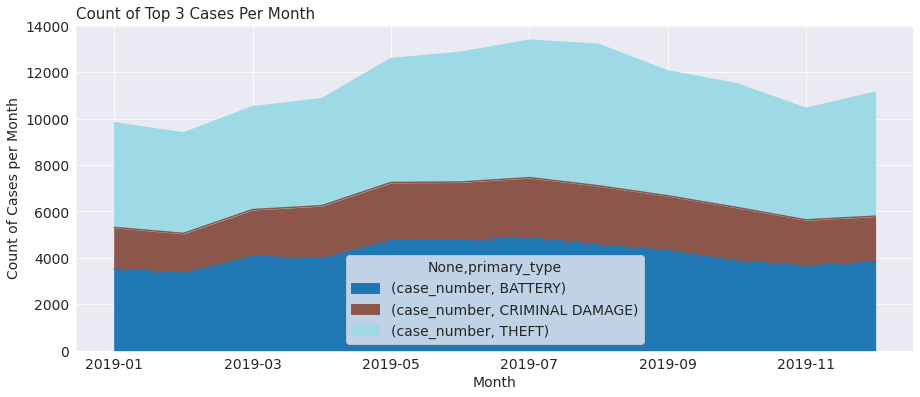

In [238]:
# Create a pivot area chart of the crimes per month
df_top3_crimes[['case_number', 'primary_type', 'year_month']].pivot_table(
    index='year_month', 
    columns='primary_type', 
    fill_value=0, 
    aggfunc='count').plot(kind='area',
                          stacked=True,
                          figsize=(15, 6),
                          colormap='tab20')

plt.xlabel('Month')
plt.ylabel('Count of Cases per Month')
plt.title('Count of Top 3 Cases Per Month', loc='left', fontsize=15)

Text(0.0, 1.0, 'Count of Top 3 Cases Per Day of Week')

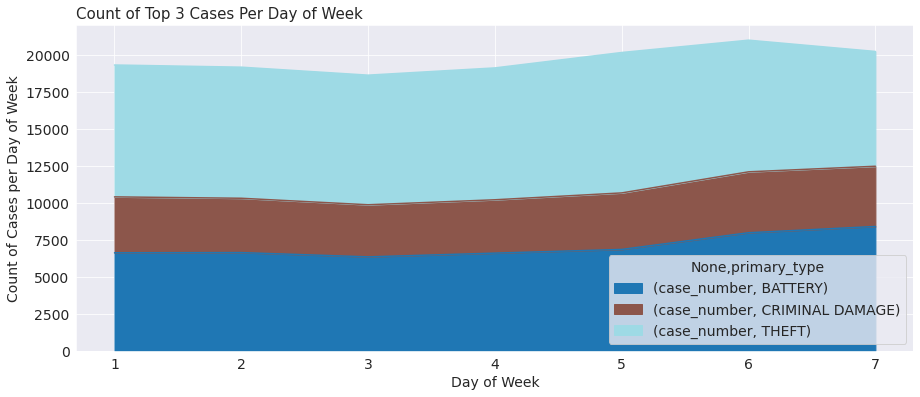

In [239]:
# Create a pivot area chart of the crimes per month
df_top3_crimes[['case_number', 'primary_type', 'day']].pivot_table(
    index='day', 
    columns='primary_type', 
    fill_value=0, 
    aggfunc='count').plot(kind='area',
                          stacked=True,
                          figsize=(15, 6),
                          colormap='tab20')

plt.xlabel('Day of Week')
plt.ylabel('Count of Cases per Day of Week')
plt.title('Count of Top 3 Cases Per Day of Week', loc='left', fontsize=15)

Text(0.0, 1.0, 'Count of Top 3 Cases Per Day of hour')

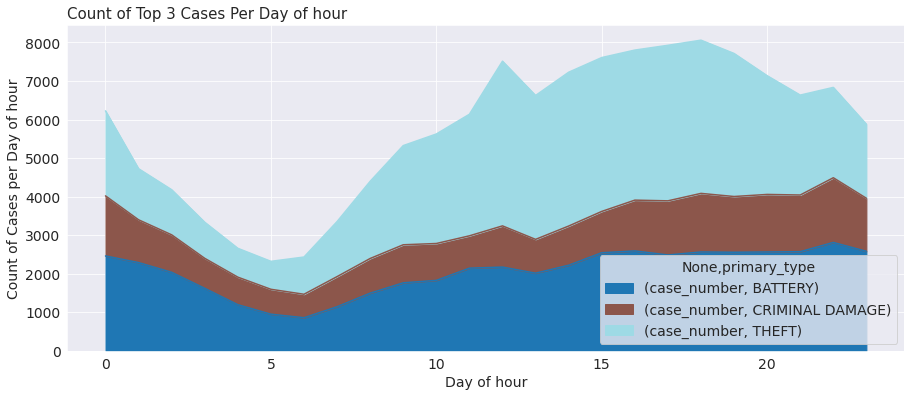

In [240]:
# Create a pivot area chart of the crimes per hour
df_top3_crimes[['case_number', 'primary_type', 'hour']].pivot_table(
    index='hour', 
    columns='primary_type', 
    fill_value=0, 
    aggfunc='count').plot(kind='area',
                          stacked=True,
                          figsize=(15, 6),
                          colormap='tab20')

plt.xlabel('Day of hour')
plt.ylabel('Count of Cases per Day of hour')
plt.title('Count of Top 3 Cases Per Day of hour', loc='left', fontsize=15)

### Crime maps

In [0]:
# Create a list of 3 colours. 
# We have  list of the top 3 crimes from earlier
colors3 = [
    'red',
    'blue',
    'green'
]

# Create a dictionary of colours to map to the crimes
dict_colours3 = dict(zip(top_three_crimes, colors3))

In [0]:
# Add the colours colums to the df_top_crimes DataFrame
df_top3_crimes['colour'] = df_top3_crimes.primary_type.map(dict_colours3)

# Filter the top 3 crimes dataframe to extract August only
df_top3_crimes_july = df_top3_crimes[df_top3_crimes.month_name == 'July']

In [243]:
df_top3_crimes_july.shape

(13374, 20)

In [0]:
# lat-long of my url bellow
chicago_latitude = 41.916841 
chicago_longitude = -87.593951

In [245]:
# Use Folium to display the Maps for Visualisation
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
from folium import plugins

# Define the world map centered around Chicago with a higher zoom level
chicago_map = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=11)

# display world map
chicago_map

# Instantiate a feature group for the incidents in the dataframe
incidents = folium.map.FeatureGroup()

# loop through the August crimes and add each to the incidents feature group
for lat, lng, col in zip(df_top3_crimes_july.latitude, 
                         df_top3_crimes_july.longitude, 
                         df_top3_crimes_july.colour):
    incidents.add_child(
        folium.CircleMarker(
            [lat, lng],
            radius=1, # define how big you want the circle markers to be
            color=col,
            fill=True,
            fill_color=col,
            fill_opacity=0.6,
        )
    )

# add incidents to map
chicago_map.add_child(incidents)

In [246]:
mc = MarkerCluster()

# Define the world map centered around Chicago with a higher zoom level
chicago_cluster = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=11)

# display world map
chicago_cluster

#creating a Marker for each point in df_sample. Each point will get a popup with their zip
for row in df_top3_crimes_july.itertuples():
    mc.add_child(folium.Marker(
        location=[row.latitude,  row.longitude],
                 popup=row.primary_type))
 
chicago_cluster.add_child(mc)
chicago_cluster

In [247]:
from folium import plugins
from folium.plugins import HeatMap

chicago_heatmat = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=11) 

# List comprehension to make out list of lists
heat_data = [[row['latitude'], 
              row['longitude']] for index, row in df_top3_crimes_july.iterrows()]

# Plot it on the map
HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=15,
        blur=20,
        gradient=None,
        overlay=True).add_to(chicago_heatmat)

# Display the map
chicago_heatmat

# Best Night Club dataset

## Start process

### Import Libraries

In [0]:
# Import Pandas to provide DataFrame support
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

# Import Requests
import requests

# Import BeautifulSoup
from bs4 import BeautifulSoup

### Credentials Foursquare API

In [0]:
#CLIENT_ID = '1GSRPB3NCRFFWC2MDXMV1311IYVY3CDCS3OAZL4MNRFCV5PL' # your Foursquare ID
#CLIENT_SECRET = 'YSGQD5AUC0VTGMY0LPL4RXNY2Z3TBXR4TISADHODOPJS55F5' # your Foursquare Secret
#VERSION = '20190410'
#LIMIT = 30
#print('Your credentails:')
#print('CLIENT_ID: ' + CLIENT_ID)
#print('CLIENT_SECRET:' + CLIENT_SECRET)

In [0]:
# Use the Requests get method to request the top sites in Chicago
#page = requests.get(
    #"https://foursquare.com/explore?mode=url&ne=41.893525%2C-87.622678&q=Nightlife&sw=41.886624%2C-87.635788")

# Convert the HTML response into a BeautifulSoup Object
#soup = BeautifulSoup(page.content, 'html.parser')

# Use the BeautifulSoup find_all method to extract each top site venue details.
#top_venues = soup.find_all('div', class_='venueDetails')

### Transform Night Club information in dataframe

In [0]:
# The column names for the top venues dataframe
venue_columns = ['id', 
                 'score', 
                 'category', 
                 'name', 
                 'address',
                 'postalcode',
                 'city',
                 'href', 
                 'latitude', 
                 'longitude']

# Create the empty top venues dataframe
df_top_venues = pd.DataFrame(columns=venue_columns)

In [0]:
# For each venue in the BeautifulSoup HTML object
for venue in top_venues:
    
     # Extract the available attributes
    venue_name = venue.find(target="_blank").get_text()
    venue_score = venue.find(class_="venueScore positive").get_text()
    venue_cat = venue.find(class_="categoryName").get_text()
    venue_href = venue.find(class_="venueName").h2.a['href']
    venue_id = venue_href.split('/')[-1]

    if 'promotedTipId' in venue_id: 
        continue
        
     # Contruct the FourSquare venue API URL
    url = 'https://api.foursquare.com/v2/venues/{}?client_id={}&client_secret={}&v={}'.format(
        venue_id, 
        CLIENT_ID,
        CLIENT_SECRET,
        VERSION)
    
    # Request the venue data
    result = requests.get(url).json()
        
    # Get the properly formatted address and the latitude and longitude
    venue_address = result['response']['venue']['location']['address']
    venue_postalcode = result['response']['venue']['location']['postalCode']
    venue_city = result['response']['venue']['location']['city']
    venue_latitude = result['response']['venue']['location']['lat']
    venue_longitude = result['response']['venue']['location']['lng']
    venue_likes= result['response']['venue']['likes']['count']
    
    # Add the venue to the top venues dataframe
    df_top_venues = df_top_venues.append({'id': venue_id,
                                          'score': venue_score,
                                          'likes': venue_likes,
                                          'category': venue_cat,
                                          'name': venue_name,
                                          'address': venue_address,
                                          'postalcode': venue_postalcode,
                                          'city': venue_city,
                                          'href': venue_href,
                                          'latitude': venue_latitude,
                                          'longitude': venue_longitude}, ignore_index=True)

In [67]:
df_top_venues

,Unnamed: 0,id,score,name,address,postalcode,city,href,latitude,longitude,category,likes
0,0,554e1fb8498eafc2606cb999,8.8,Broken Shaker,19 E Ohio St,60611,Chicago,/v/broken-shaker/554e1fb8498eafc2606cb999,41.892488,-87.627336,Cocktail,300
1,1,5774640fcd100a944f17f4e9,8.5,London House Rooftop Bar,85 E Wacker Dr,60601,Chicago,/v/london-house-rooftop-bar/5774640fcd100a944f...,41.888031,-87.625264,Hotel Bar,111
2,2,4b7ecfe4f964a520470130e3,9.2,Gilt Bar,230 W Kinzie St,60654,Chicago,/v/gilt-bar/4b7ecfe4f964a520470130e3,41.889236,-87.635377,Bar,464
3,3,51ca4b11498eb327cdb072b1,8.8,The Berkshire Room,15 E Ohio St,60611,Chicago,/v/the-berkshire-room/51ca4b11498eb327cdb072b1,41.892495,-87.627476,Bar,239
4,4,5736ab1f498e4ad304e06cfa,8.8,Raised Rooftop at Renaissance Hotel,1 W Wacker Dr,60601,Chicago,/v/raised-rooftop-at-renaissance-hotel/5736ab1...,41.886726,-87.628110,Bar,104
5,5,5bee0aab9cadd9002c6261ba,8.7,Bar Sótano,445 N Clark St,60654,Chicago,/v/bar-s%C3%B3tano/5bee0aab9cadd9002c6261ba,41.890518,-87.630947,Bar,21
6,6,4af47a58f964a520e8f221e3,8.6,La Mez Agave Lounge,108 W Kinzie St,60654,Chicago,/v/la-mez-agave-lounge/4af47a58f964a520e8f221e3,41.889196,-87.631510,Cocktail,47
7,7,5cc8c857491be7002c739a51,8.5,The Smith,400 N Clark St,60654,Chicago,/v/the-smith/5cc8c857491be7002c739a51,41.889417,-87.631070,Bar,31
8,8,4c49f8995609c9b60ad7078f,8.5,Watershed,601 N State St,60654,Chicago,/v/watershed/4c49f8995609c9b60ad7078f,41.892597,-87.628059,Cocktail,154
9,9,4a5428b6f964a52016b31fe3,8.4,Pops for Champagne,601 N State St,60654,Chicago,/v/pops-for-champagne/4a5428b6f964a52016b31fe3,41.892530,-87.628038,Wine Bar,283


## Clean up the and prepare

### Some modifications

In [253]:
df_top_venues.shape

(30, 15)

In [69]:
df_top_venues.dtypes

Unnamed: 0      int64
id             object
score         float64
name           object
address        object
postalcode      int64
city           object
href           object
latitude      float64
longitude     float64
category       object
likes           int64
dtype: object

In [68]:
# Review the head of the dataframe to make sure it looks as expected
df_top_venues

,Unnamed: 0,id,score,name,address,postalcode,city,href,latitude,longitude,category,likes
0,0,554e1fb8498eafc2606cb999,8.8,Broken Shaker,19 E Ohio St,60611,Chicago,/v/broken-shaker/554e1fb8498eafc2606cb999,41.892488,-87.627336,Cocktail,300
1,1,5774640fcd100a944f17f4e9,8.5,London House Rooftop Bar,85 E Wacker Dr,60601,Chicago,/v/london-house-rooftop-bar/5774640fcd100a944f...,41.888031,-87.625264,Hotel Bar,111
2,2,4b7ecfe4f964a520470130e3,9.2,Gilt Bar,230 W Kinzie St,60654,Chicago,/v/gilt-bar/4b7ecfe4f964a520470130e3,41.889236,-87.635377,Bar,464
3,3,51ca4b11498eb327cdb072b1,8.8,The Berkshire Room,15 E Ohio St,60611,Chicago,/v/the-berkshire-room/51ca4b11498eb327cdb072b1,41.892495,-87.627476,Bar,239
4,4,5736ab1f498e4ad304e06cfa,8.8,Raised Rooftop at Renaissance Hotel,1 W Wacker Dr,60601,Chicago,/v/raised-rooftop-at-renaissance-hotel/5736ab1...,41.886726,-87.628110,Bar,104
5,5,5bee0aab9cadd9002c6261ba,8.7,Bar Sótano,445 N Clark St,60654,Chicago,/v/bar-s%C3%B3tano/5bee0aab9cadd9002c6261ba,41.890518,-87.630947,Bar,21
6,6,4af47a58f964a520e8f221e3,8.6,La Mez Agave Lounge,108 W Kinzie St,60654,Chicago,/v/la-mez-agave-lounge/4af47a58f964a520e8f221e3,41.889196,-87.631510,Cocktail,47
7,7,5cc8c857491be7002c739a51,8.5,The Smith,400 N Clark St,60654,Chicago,/v/the-smith/5cc8c857491be7002c739a51,41.889417,-87.631070,Bar,31
8,8,4c49f8995609c9b60ad7078f,8.5,Watershed,601 N State St,60654,Chicago,/v/watershed/4c49f8995609c9b60ad7078f,41.892597,-87.628059,Cocktail,154
9,9,4a5428b6f964a52016b31fe3,8.4,Pops for Champagne,601 N State St,60654,Chicago,/v/pops-for-champagne/4a5428b6f964a52016b31fe3,41.892530,-87.628038,Wine Bar,283


In [71]:
df_top_venues.sort_values(by='likes', ascending=False).head(3)

,Unnamed: 0,id,score,name,address,postalcode,city,href,latitude,longitude,category,likes
10,10,51f7183b8bbdc6a6ae21592e,8.6,Three Dots and a Dash,435 N Clark St,60654,Chicago,/v/three-dots-and-a-dash/51f7183b8bbdc6a6ae21592e,41.890270,-87.630690,Tiki Bar,917
26,26,4ca4d2a4d695199c9a9451e7,7.7,Public House,400 North State Street,60654,Chicago,/v/public-house/4ca4d2a4d695199c9a9451e7,41.889474,-87.628274,Bar,575
2,2,4b7ecfe4f964a520470130e3,9.2,Gilt Bar,230 W Kinzie St,60654,Chicago,/v/gilt-bar/4b7ecfe4f964a520470130e3,41.889236,-87.635377,Bar,464


In [0]:
# Saving df in my drive

# Import Drive API and authenticate.
from google.colab import drive

# Mount your Drive to the Colab VM.
drive.mount('/gdrive')

# Write the DataFrame to CSV file.
with open('/gdrive/My Drive/data_science_capstone/df_top_venues.csv', 'w') as f:
  df_top_venues.to_csv(f)

### Create a top 3 Night clubs

In [0]:
df_top3_venues = df_top_venues.sort_values(by='likes', ascending=False).head(3)

In [73]:
df_top3_venues

,Unnamed: 0,id,score,name,address,postalcode,city,href,latitude,longitude,category,likes
10,10,51f7183b8bbdc6a6ae21592e,8.6,Three Dots and a Dash,435 N Clark St,60654,Chicago,/v/three-dots-and-a-dash/51f7183b8bbdc6a6ae21592e,41.890270,-87.630690,Tiki Bar,917
26,26,4ca4d2a4d695199c9a9451e7,7.7,Public House,400 North State Street,60654,Chicago,/v/public-house/4ca4d2a4d695199c9a9451e7,41.889474,-87.628274,Bar,575
2,2,4b7ecfe4f964a520470130e3,9.2,Gilt Bar,230 W Kinzie St,60654,Chicago,/v/gilt-bar/4b7ecfe4f964a520470130e3,41.889236,-87.635377,Bar,464


In [0]:
with open('/gdrive/My Drive/data_science_capstone/df_top3_venues.csv', 'w') as f:
  df_top3_venues.to_csv(f)

## Night club maps

In [263]:
nc_top3_map = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=13)

# display world map
nc_top3_map

# Instantiate a feature group for the incidents in the dataframe
incidents = folium.map.FeatureGroup()

# loop through the August crimes and add each to the incidents feature group
for lat, lng in zip(df_top3_venues.latitude, 
                    df_top3_venues.longitude):
    incidents.add_child(
        folium.Marker(
            [lat, lng],
            tooltip = 'Click me!' # define how big you want the circle markers to be,
        )
    )

# add incidents to map
nc_top3_map.add_child(incidents)

In [264]:
top3_venues_list = df_top3_venues.name.tolist()
top3_venues_list

['Three Dots and a Dash', 'Public House', 'Gilt Bar']

In [161]:
from folium import plugins
from folium.plugins import HeatMap

chicago_heatmat = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=13) 

# List comprehension to make out list of lists
heat_data = [[row['latitude'], 
              row['longitude']] for index, row in df_top3_crimes.iterrows()]

# Plot it on the map
HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=15,
        blur=20,
        gradient=None,
        overlay=True).add_to(chicago_heatmat)

for row in df_top_venues.itertuples():
    popup_text = '<h4>' + row.name + '</h4>'
    popup_text = popup_text + '<h5>' + row.category + '</h5>'
    popup_text = popup_text + '<b>Score: </b>' + str(row.score)
    popup_text = popup_text + '<b>Likes: </b>' + str(row.likes)
    popup = folium.Popup(popup_text)
    folium.Marker([row.latitude, row.longitude], 
                  tooltip = 'Click me!',
                  popup=popup,
                  icon=folium.Icon(color='black', icon='info-sign')
                 ).add_to(chicago_heatmat)

for row in df_top3_venues.itertuples():
    popup_text = '<h4>' + row.name + '</h4>'
    popup_text = popup_text + '<h5>' + row.category + '</h5>'
    popup_text = popup_text + '<b>Score: </b>' + str(row.score)
    popup_text = popup_text + '<b>Likes: </b>' + str(row.likes)
    popup = folium.Popup(popup_text)
    folium.Marker([row.latitude, row.longitude], 
                  tooltip = 'Click me!',
                  popup=popup,
                  icon=folium.Icon(color='red', icon='info-sign')
                 ).add_to(chicago_heatmat)

# Display the map
chicago_heatmat   

# Modeling

## Start process

### Libraries

In [0]:
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import BernoulliNB
from sklearn.ensemble import RandomForestClassifier
from sklearn import metrics
from sklearn.model_selection import KFold, cross_val_score

%matplotlib inline 

import matplotlib as mpl
import matplotlib.pyplot as plt

import seaborn as sns
sns.set_style("darkgrid")

font = {'size'   : 12}
mpl.rc('font', **font)

# Decision Tree
from datetime import datetime
from sklearn.tree import DecisionTreeClassifier

### X-Fold Cross Validation

In [0]:
# Function X-Fold Cross Validation
def cross_validate(model, n_splits = 10):
    
    k_fold = KFold(n_splits = n_splits)
    scores = [model.fit(X[train], y[train]).score(X[test], y[test]) for train, test in k_fold.split(X)]
    
    scores = np.percentile(scores, [40, 50, 60])
    return scores

## Clean up the data and prepare

### Transform dataframa in only numerical and remove descriptive columns

In [0]:
# Start by copying the Latitude and Longitude to the new DataFrame
df_features = crime_2019[['latitude', 'longitude']]

# Next and One Hot Encoding of the hour, day and month variables
df_features = df_features.join(pd.get_dummies(crime_2019.hour, prefix='hour'))
df_features = df_features.join(pd.get_dummies(crime_2019.day_name))
df_features = df_features.join(pd.get_dummies(crime_2019.month_name))

# Finally add the ward & crimes column, copied from the original Primary Description column
df_features['ward'] = crime_2019[['ward']]
df_features['crimes'] = crime_2019[['primary_type']]

In [82]:
df_features.head(10)

,latitude,longitude,hour_0,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,hour_9,hour_10,hour_11,hour_12,hour_13,hour_14,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,April,August,December,February,January,July,June,March,May,November,October,September,ward,crimes
0,41.739860,-87.601274,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,8.0,CRIMINAL SEXUAL ASSAULT
1,41.723978,-87.646929,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,21.0,OFFENSE INVOLVING CHILDREN
2,41.776227,-87.699411,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,17.0,CRIMINAL SEXUAL ASSAULT
3,41.710207,-87.624797,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,9.0,CRIMINAL SEXUAL ASSAULT
4,41.921370,-87.760978,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,36.0,BATTERY
5,41.900968,-87.759497,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,37.0,BATTERY
6,41.893904,-87.766634,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,29.0,BATTERY
7,41.693170,-87.650530,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,34.0,BATTERY
8,41.782211,-87.692261,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,16.0,OFFENSE INVOLVING CHILDREN
9,41.897874,-87.770367,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,29.0,SEX OFFENSE


In [0]:
with open('/gdrive/My Drive/data_science_capstone/df_features.csv', 'w') as f:
  df_features.to_csv(f)

In [0]:
# Create a list of the 2 most commonly occuring crimes
top_two_crimes = df_features[['crimes', 'ward']].groupby(
    ['crimes']).count().sort_values('ward', ascending=False)[:2].axes[0].tolist()

# Create a smaller DataFrame of only the top two crimes
df_top2_crimes = df_features[df_features['crimes'].isin(top_two_crimes)].copy()

In [22]:
df_top2_crimes.head()

,latitude,longitude,hour_0,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,hour_9,hour_10,hour_11,hour_12,hour_13,hour_14,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,April,August,December,February,January,July,June,March,May,November,October,September,ward,crimes
0,41.750049,-87.690529,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,18.0,BATTERY
1,41.968803,-87.718266,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,35.0,BATTERY
2,41.757175,-87.634463,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,6.0,BATTERY
3,41.921370,-87.760978,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,36.0,BATTERY
4,41.900968,-87.759497,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,37.0,BATTERY


In [0]:
# Create the X, dependant variables, DataFrames by dropping the Crimes column
X_2 = df_top2_crimes.copy()
y_2 = X_2.crimes.values

X_2.drop('crimes', axis=1, inplace=True)
X_2 = preprocessing.StandardScaler().fit(X_2).transform(X_2)

In [0]:
# Normailse the X Data
# Set X = X_2
X = X_2
y = y_2

## Models

###  K Nearest Neighbor(KNN

Heighbours:  8   2020-04-14 11:39:33.296261
Heighbours:  9   2020-04-14 11:58:57.334631
Heighbours:  10   2020-04-14 12:18:30.476200
Heighbours:  11   2020-04-14 12:37:24.502584
Heighbours:  12   2020-04-14 12:56:40.718368


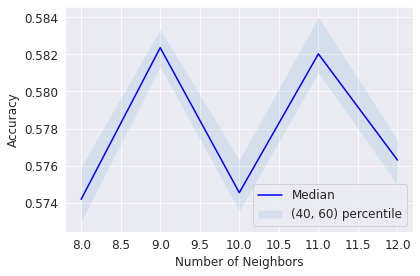

In [140]:
# Number of neighbours
neighs = range(8, 13)

# Store the scores
scores = np.zeros((len(neighs), 3))

# Iterate to find the best model
for idx, neigh in enumerate(neighs):
    print('Heighbours: ', neigh, ' ', str(datetime.now()))
    model = KNeighborsClassifier(n_neighbors = neigh)
    scores[idx, : ] = cross_validate(model, n_splits = 10)

# Plot the results
plt.plot(neighs, scores[ : , 1], 'b')
plt.fill_between(neighs, scores[ : , 0], scores[:, 2], alpha = 0.1)
plt.legend(('Median', '(40, 60) percentile'))
plt.ylabel('Accuracy')
plt.xlabel('Number of Neighbors')
plt.tight_layout()
plt.show()

In [0]:
KNN_model = KNeighborsClassifier(n_neighbors = 9).fit(X, y)

sim


### Decision Tree

Depth:  12   2020-04-14 11:22:37.171828
Depth:  13   2020-04-14 11:22:49.587633
Depth:  14   2020-04-14 11:23:01.754843
Depth:  15   2020-04-14 11:23:13.878943
Depth:  16   2020-04-14 11:23:26.430570
Depth:  17   2020-04-14 11:23:39.539926


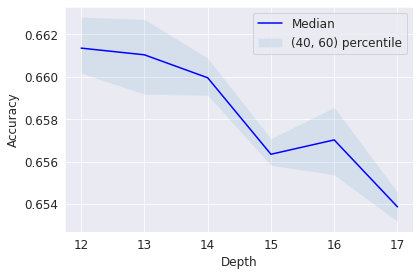

In [85]:
# Decision Tree
from datetime import datetime
from sklearn.tree import DecisionTreeClassifier

# Depth of the Secision Trees
depths = range(12, 18)

# Store the scores
scores = np.zeros((len(depths), 3))

# Iterate to find the best model
for idx, depth in enumerate(depths):
    print('Depth: ', depth, ' ', str(datetime.now()))
    model = DecisionTreeClassifier(criterion = "entropy", max_depth = depth)
    scores[idx, : ] = cross_validate(model, n_splits = 10)

# Plot the results
plt.plot(depths, scores[ : , 1], 'b')
plt.fill_between(depths, scores[ : , 0], scores[:, 2], alpha = 0.1)
plt.legend(('Median', '(40, 60) percentile'))
plt.ylabel('Accuracy')
plt.xlabel('Depth')
plt.tight_layout()
plt.show()

In [0]:
Tree_model = DecisionTreeClassifier(criterion = "entropy", max_depth = 12).fit(X, y)

### Logistic Regression

C:  0.01   2020-04-14 11:24:01.366071
C:  0.03162277660168379   2020-04-14 11:24:10.169375
C:  0.1   2020-04-14 11:24:18.775032
C:  0.31622776601683794   2020-04-14 11:24:27.451008
C:  1.0   2020-04-14 11:24:36.063854
C:  3.1622776601683795   2020-04-14 11:24:44.727775


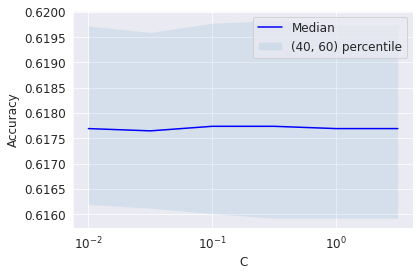

In [86]:
# Logistic Regression

from sklearn.linear_model import LogisticRegression

C = np.logspace(-2.0, 0.5, num = 6, endpoint = True)

scores = np.zeros((len(C), 3))

for idx, c in enumerate(C):
    print('C: ', c, ' ', str(datetime.now()))
    model = LogisticRegression(C = c, solver = 'liblinear')
    scores[idx, : ] = cross_validate(model, n_splits = 10)

plt.plot(C, scores[ : , 1], 'b')
plt.xscale('log')
plt.fill_between(C, scores[ : , 0], scores[:, 2], alpha = 0.1)
plt.legend(('Median', '(40, 60) percentile'))
plt.ylabel('Accuracy')
plt.xlabel('C')
plt.tight_layout()
plt.show()

In [0]:
LR_model = LogisticRegression(C = 0.1, solver = 'liblinear').fit(X, y)

### Naive Bayes

Alpha:  0.1   2020-04-14 11:25:58.705666
Alpha:  0.2   2020-04-14 11:26:03.876223
Alpha:  0.30000000000000004   2020-04-14 11:26:09.050006
Alpha:  0.4   2020-04-14 11:26:14.183219
Alpha:  0.5   2020-04-14 11:26:19.371613
Alpha:  0.6   2020-04-14 11:26:24.533896
Alpha:  0.7000000000000001   2020-04-14 11:26:29.713495
Alpha:  0.8   2020-04-14 11:26:34.871969
Alpha:  0.9   2020-04-14 11:26:40.041951
Alpha:  1.0   2020-04-14 11:26:45.203379


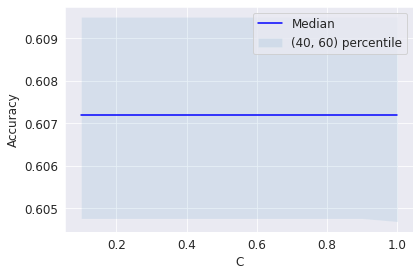

In [89]:
# Naive Bayes

alpha = np.linspace(0.1, 1, num=10)

scores = np.zeros((len(alpha), 3))

for idx, a in enumerate(alpha):
    print('Alpha: ', a, ' ', str(datetime.now()))
    model = BernoulliNB(alpha=a)
    scores[idx, : ] = cross_validate(model, n_splits = 10)

plt.plot(alpha, scores[ : , 1], 'b')
plt.fill_between(alpha, scores[ : , 0], scores[:, 2], alpha = 0.1)
plt.legend(('Median', '(40, 60) percentile'))
plt.ylabel('Accuracy')
plt.xlabel('C')
plt.tight_layout()
plt.show()

In [0]:
NB_model = BernoulliNB(alpha=a).fit(X, y)

### Decision Forest using a Random Forest

Estimator:  20   2020-04-14 11:26:58.111537
Estimator:  21   2020-04-14 11:27:36.607867
Estimator:  22   2020-04-14 11:28:17.126355
Estimator:  23   2020-04-14 11:28:59.199545


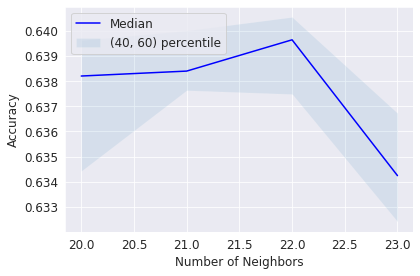

In [91]:
est = range(20, 24)
scores = np.zeros((len(est), 3))
for idx, a in enumerate(est):
    print('Estimator: ', a, ' ', str(datetime.now()))
    model = RandomForestClassifier(n_estimators = a, max_features = 'sqrt')
    scores[idx, : ] = cross_validate(model, n_splits = 10)

plt.plot(est, scores[ : , 1], 'b')
plt.fill_between(est, scores[ : , 0], scores[:, 2], alpha = 0.1)
plt.legend(('Median', '(40, 60) percentile'))
plt.ylabel('Accuracy')
plt.xlabel('Number of Neighbors')
plt.tight_layout()
plt.show()

In [0]:
Forest_model = RandomForestClassifier(n_estimators = 22, max_features = 'sqrt').fit(X, y)

### Define best model to use

In [144]:
# Function to iterate over each of the models to get their scores
def get_scores(model):

    # predict
    yhat = model.predict(X)
    
    jaccard = metrics.jaccard_similarity_score(y, yhat)
    f1 = metrics.f1_score(y, yhat, pos_label = 'THEFT')
    logloss = metrics.log_loss(y == 'THEFT', yhat == 'THEFT')
        
    return {'Jaccard' : jaccard, 'F1-Score' : f1, 'LogLoss' : logloss}

# Empty Results List    
results = []

# The Models
models = [[KNN_model, 'KNN'], 
          [Tree_model, 'Decision Tree'], 
          [NB_model, 'Bernoulli Naive Bayes'], 
          [LR_model, 'Logistic Regression'],
          [Forest_model, 'Random Forest']]

# Iterate over each of the models
for model, algorithm in models:
    
    scores = get_scores(model)
    scores['Algorithm'] = algorithm
    results.append(scores)

# Format the results and display them.
results = pd.DataFrame(results)
results.set_index('Algorithm', inplace = True)

results

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:664: FutureWarning: jaccard_similarity_score has been deprecated and replaced with jaccard_score. It will be removed in version 0.23. This implementation has surprising behavior for binary and multiclass classification tasks.
  FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:664: FutureWarning: jaccard_similarity_score has been deprecated and replaced with jaccard_score. It will be removed in version 0.23. This implementation has surprising behavior for binary and multiclass classification tasks.
  FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:664: FutureWarning: jaccard_similarity_score has been deprecated and replaced with jaccard_score. It will be removed in version 0.23. This implementation has surprising behavior for binary and multiclass classification tasks.
  FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/me

,Jaccard,F1-Score,LogLoss
Algorithm,,,
KNN,0.699465,0.729000,10.380224
Decision Tree,0.695396,0.710063,10.520755
Bernoulli Naive Bayes,0.612360,0.664197,13.388800
Logistic Regression,0.621705,0.685819,13.066041
Random Forest,0.995606,0.996037,0.151749


In [0]:
with open('/gdrive/My Drive/data_science_capstone/results.csv', 'w') as f:
  results.to_csv(f)

### Recreate the Features DataFrame
Recreate the Features DataFrame but this time use all of the data.

In [0]:
crime_2019c.drop('Unnamed: 0', inplace=True, axis=1)

In [0]:
# Start by copying the Latitude and Longitude to the new DataFrame
df_features = crime_2019c[['latitude', 'longitude']]

# Next and One Hot Encoding of the hour, day and month variables
df_features = df_features.join(pd.get_dummies(crime_2019c.hour, prefix='hour'))
df_features = df_features.join(pd.get_dummies(crime_2019c.day_name))
df_features = df_features.join(pd.get_dummies(crime_2019c.month_name))

# Finally add the ward & crimes column, copied from the original Primary Description column
df_features['ward'] = crime_2019c[['ward']]
df_features['crimes'] = crime_2019c[['primary_type']]

# Create a list of the 2 most commonly occuring crimes
top_two_crimes = df_features[['crimes', 'ward']].groupby(
    ['crimes']).count().sort_values('ward', ascending=False)[:2].axes[0].tolist()

# Create a smaller DataFrame of only the top two crimes
df_features = df_features[df_features['crimes'].isin(top_two_crimes)].copy()

In [102]:
df_features.head()

,latitude,longitude,hour_0,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,hour_9,hour_10,hour_11,hour_12,hour_13,hour_14,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,April,August,December,February,January,July,June,March,May,November,October,September,ward,crimes
0,41.750049,-87.690529,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,18.0,BATTERY
1,41.968803,-87.718266,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,35.0,BATTERY
2,41.757175,-87.634463,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,6.0,BATTERY
3,41.921370,-87.760978,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,36.0,BATTERY
4,41.900968,-87.759497,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,37.0,BATTERY


In [103]:
df_features.dtypes

latitude     float64
longitude    float64
hour_0         uint8
hour_1         uint8
hour_2         uint8
hour_3         uint8
hour_4         uint8
hour_5         uint8
hour_6         uint8
hour_7         uint8
hour_8         uint8
hour_9         uint8
hour_10        uint8
hour_11        uint8
hour_12        uint8
hour_13        uint8
hour_14        uint8
hour_15        uint8
hour_16        uint8
hour_17        uint8
hour_18        uint8
hour_19        uint8
hour_20        uint8
hour_21        uint8
hour_22        uint8
hour_23        uint8
Friday         uint8
Monday         uint8
Saturday       uint8
Sunday         uint8
Thursday       uint8
Tuesday        uint8
Wednesday      uint8
April          uint8
August         uint8
December       uint8
February       uint8
January        uint8
July           uint8
June           uint8
March          uint8
May            uint8
November       uint8
October        uint8
September      uint8
ward         float64
crimes        object
dtype: object

### Create test and train

In [0]:
X_Train = df_features[df_features.January == 0].copy()
X_Train.drop('crimes', axis=1, inplace=True)

# Normalise df_features
X_Train = preprocessing.StandardScaler().fit(X_Train).transform(X_Train)

y_Train = df_features.crimes[df_features.January == 0].values

In [0]:
X_Test = df_features[df_features.January == 1].copy()
X_Test.drop('crimes', axis=1, inplace=True)

# Normalise df_features
X_Test = preprocessing.StandardScaler().fit(X_Test).transform(X_Test)

y_Test = df_features.crimes[df_features.January == 1].values

### Recreate the Random Forest Mode and the predict model

In [0]:
Forest_model_final = RandomForestClassifier(n_estimators = 22, max_features = 'sqrt').fit(X_Train, y_Train)

In [107]:
# Predict yhat using X_Test
yhat = Forest_model_final.predict(X_Test)
    
# Measure the Jaccard Score of the final Model
jaccard_final = metrics.jaccard_similarity_score(y_Test, yhat)
print('Jaccard Score', jaccard_final)
    
f1 = metrics.f1_score(y_Test, yhat, average=None)
print('F1-Score of each class', f1)

Jaccard Score 0.6454749439042633
F1-Score of each class [0.60123388 0.68087971]


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:664: FutureWarning: jaccard_similarity_score has been deprecated and replaced with jaccard_score. It will be removed in version 0.23. This implementation has surprising behavior for binary and multiclass classification tasks.
  FutureWarning)


### Importance that each feature

In [0]:
importances = Forest_model_final.feature_importances_

Feature ranking:
1. feature 0 (0.272434)
2. feature 1 (0.258708)
3. feature 45 (0.121441)
4. feature 38 (0.012932)
5. feature 30 (0.012484)
6. feature 39 (0.012481)
7. feature 26 (0.012206)
8. feature 31 (0.012174)
9. feature 27 (0.011969)
10. feature 32 (0.011942)
11. feature 34 (0.011938)
12. feature 44 (0.011928)
13. feature 43 (0.011638)
14. feature 35 (0.011304)
15. feature 42 (0.011109)
16. feature 33 (0.011006)
17. feature 41 (0.010874)
18. feature 40 (0.010727)
19. feature 36 (0.010639)
20. feature 28 (0.010313)
21. feature 29 (0.008531)
22. feature 18 (0.007736)
23. feature 17 (0.007726)
24. feature 21 (0.007338)
25. feature 13 (0.007017)
26. feature 20 (0.006918)
27. feature 22 (0.006905)
28. feature 19 (0.006691)
29. feature 23 (0.006393)
30. feature 24 (0.006213)
31. feature 11 (0.006060)
32. feature 16 (0.006028)
33. feature 10 (0.005960)
34. feature 12 (0.005959)
35. feature 2 (0.005875)
36. feature 15 (0.005666)
37. feature 9 (0.005512)
38. feature 3 (0.005458)
39. featu

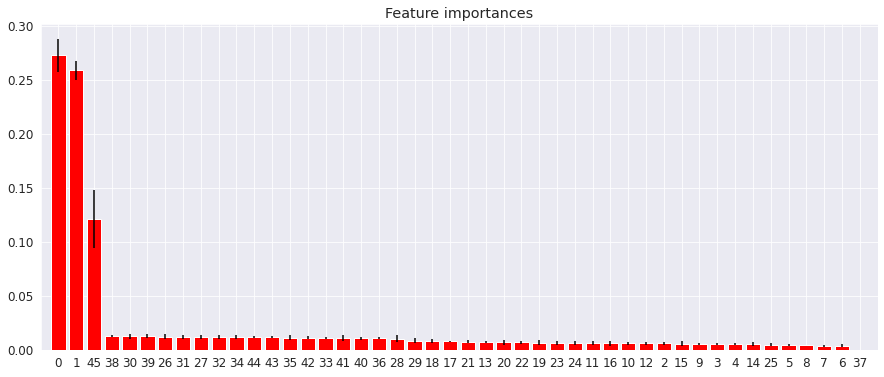

In [109]:
std = np.std([tree.feature_importances_ for tree in Forest_model_final.estimators_],
             axis=0)

indices = np.argsort(importances)[::-1]

# Print the feature ranking
print("Feature ranking:")

for f in range(X_Train.shape[1]):
    print("%d. feature %d (%f)" % (f + 1, indices[f], importances[indices[f]]))

# Plot the feature importances of the forest
plt.figure(figsize=(15, 6))
plt.title("Feature importances")
plt.bar(range(X_Train.shape[1]), importances[indices],
       color="r", yerr=std[indices], align="center")
plt.xticks(range(X_Train.shape[1]), indices)
plt.xlim([-1, X_Train.shape[1]])
plt.show()

**This shows that the most predictive models are:**
1.   Latitude
2.   Longitude
3.   Ward


In [0]:
Tree_model = DecisionTreeClassifier(criterion = "entropy", max_depth = 15).fit(X_Train, y_Train)

In [111]:

# Predict yhat using X_Test
yhat_dt = Forest_model_final.predict(X_Test)
    
# Measure the Jaccard Score of the final Model
jaccard_final = metrics.jaccard_similarity_score(y_Test, yhat_dt)
print('Jaccard Score', jaccard_final)
    
f1 = metrics.f1_score(y_Test, yhat_dt, average=None)
print('F1-Score of each class', f1)

Jaccard Score 0.6454749439042633
F1-Score of each class [0.60123388 0.68087971]


/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:664: FutureWarning: jaccard_similarity_score has been deprecated and replaced with jaccard_score. It will be removed in version 0.23. This implementation has surprising behavior for binary and multiclass classification tasks.
  FutureWarning)


## Prediction

### Libraries

In [0]:
import pandas as pd

# Import Numpy
import numpy as np

# All the SciKit Learn Libraries Required
from sklearn import preprocessing
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import BernoulliNB
from sklearn.ensemble import RandomForestClassifier
from sklearn import metrics
from sklearn.model_selection import KFold, cross_val_score

from random import randint

# Use Folium to display the Maps for Visualisation
import folium
from folium.plugins import MarkerCluster
from folium.plugins import FastMarkerCluster
from folium import plugins

from folium import plugins
from folium.plugins import HeatMap

from sklearn.neighbors import DistanceMetric


### Aditional information

In [0]:
# Very useful function to calculate the great circle distance between two points
# Found here and adapted:
# https://stackoverflow.com/questions/40452759/pandas-latitude-longitude-to-distance-between-successive-rows

#def haversine(row):
    #dist = DistanceMetric.get_metric('haversine')
   
    #lat1, lon1, lat2, lon2 = map(np.radians, [row['latitude'], 
                                              #row['longitude'], 
                                              #row['ven_lat'], 
                                              #row['ven_lon']])

    #X = [[lat1, lon1],
         [lat2, lon2]]
    
    #kms = 6367
    
    #return kms * dist.pairwise(X)[0][1]

### Process 1
Fake Crime Data
Next we'll generate the fake crime data. The crimes will be equally divided between a no crimes happened 0 and crime happened 1. The Random Forest model will be trainined again on the data from February 2019 to December 2019 and tested against January 2019 to predict the acccuracy of the model.

A new test dataset will then be created for each location in the Top Venues DataFrame and for each Restaurant associated with each of the top Venues. A random visit Date, in January 2019 (view **Create test and train** above), and time will be associated with each row and then a prediction will be made whether a crime would be committed at each location and date or not.

In [0]:
df_features['random_crimes'] = np.random.randint(0, 2, df_features.shape[0])

In [114]:
df_features.head()

,latitude,longitude,hour_0,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,hour_9,hour_10,hour_11,hour_12,hour_13,hour_14,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,April,August,December,February,January,July,June,March,May,November,October,September,ward,crimes,random_crimes
0,41.750049,-87.690529,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,18.0,BATTERY,1
1,41.968803,-87.718266,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,35.0,BATTERY,0
2,41.757175,-87.634463,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,6.0,BATTERY,1
3,41.921370,-87.760978,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,36.0,BATTERY,1
4,41.900968,-87.759497,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,37.0,BATTERY,0


In [115]:
df_features.shape

(111072, 48)

In [0]:
feature_cols = df_features.columns.tolist()

### Create the Test Datasets and Recreate the Random Forest Model

In [0]:
# Create the Train Dataset
X_Train = df_features.copy()
X_Train.drop('crimes', axis=1, inplace=True)
X_Train.drop('random_crimes', axis=1, inplace=True)
X_Train.drop('ward', axis=1, inplace=True)

# Normalise df_features
X_Train = preprocessing.StandardScaler().fit(X_Train).transform(X_Train)

y_Train = df_features.random_crimes.values

In [0]:
Forest_model_final = RandomForestClassifier(n_estimators = 22, max_features = 'sqrt').fit(X_Train, y_Train)

### Build the DataFrame of Potential Venue visits

In [120]:
  #Join the two dataframes
df_final = df_top_venues

# Drop duplicate entries
df_final.drop_duplicates(keep=False, inplace=True)
df_final.drop('Unnamed: 0', inplace=True, axis=1)
df_final

,id,score,name,address,postalcode,city,href,latitude,longitude,category,likes
0,554e1fb8498eafc2606cb999,8.8,Broken Shaker,19 E Ohio St,60611,Chicago,/v/broken-shaker/554e1fb8498eafc2606cb999,41.892488,-87.627336,Cocktail,300
1,5774640fcd100a944f17f4e9,8.5,London House Rooftop Bar,85 E Wacker Dr,60601,Chicago,/v/london-house-rooftop-bar/5774640fcd100a944f...,41.888031,-87.625264,Hotel Bar,111
2,4b7ecfe4f964a520470130e3,9.2,Gilt Bar,230 W Kinzie St,60654,Chicago,/v/gilt-bar/4b7ecfe4f964a520470130e3,41.889236,-87.635377,Bar,464
3,51ca4b11498eb327cdb072b1,8.8,The Berkshire Room,15 E Ohio St,60611,Chicago,/v/the-berkshire-room/51ca4b11498eb327cdb072b1,41.892495,-87.627476,Bar,239
4,5736ab1f498e4ad304e06cfa,8.8,Raised Rooftop at Renaissance Hotel,1 W Wacker Dr,60601,Chicago,/v/raised-rooftop-at-renaissance-hotel/5736ab1...,41.886726,-87.628110,Bar,104
5,5bee0aab9cadd9002c6261ba,8.7,Bar Sótano,445 N Clark St,60654,Chicago,/v/bar-s%C3%B3tano/5bee0aab9cadd9002c6261ba,41.890518,-87.630947,Bar,21
6,4af47a58f964a520e8f221e3,8.6,La Mez Agave Lounge,108 W Kinzie St,60654,Chicago,/v/la-mez-agave-lounge/4af47a58f964a520e8f221e3,41.889196,-87.631510,Cocktail,47
7,5cc8c857491be7002c739a51,8.5,The Smith,400 N Clark St,60654,Chicago,/v/the-smith/5cc8c857491be7002c739a51,41.889417,-87.631070,Bar,31
8,4c49f8995609c9b60ad7078f,8.5,Watershed,601 N State St,60654,Chicago,/v/watershed/4c49f8995609c9b60ad7078f,41.892597,-87.628059,Cocktail,154
9,4a5428b6f964a52016b31fe3,8.4,Pops for Champagne,601 N State St,60654,Chicago,/v/pops-for-champagne/4a5428b6f964a52016b31fe3,41.892530,-87.628038,Wine Bar,283



### Add a randon Date / Time to visit each location and format


In [0]:
# Add a randon Date / Time to visit each locatio

# Year will always be 2018
year = 2019

# Empty list to hold the dates
dates = []

# Generate a random date for each entry in the dataframe
for i in range(0, df_final.shape[0]):
    month = randint(1, 12)
    day = randint(1, 28)
    hour = randint(0, 23)
    minute = randint(0, 59)
    date = '{:02d}-{:02d}-{:02d} {:02d}:{:02d}:00'.format(month,
                                      day,
                                      year,
                                      hour,
                                      minute)
    dates.append(date)

In [0]:
# We now have a date for each
se = pd.Series(dates)


In [0]:

# Then add the values to the DataFrame:
df_final['date'] = se.values


In [0]:

# Convert the date to a proper DateTime Object
df_final['date'] =  pd.to_datetime(df_final['date'], format='%m-%d-%Y %H:%M:%S')

In [148]:
df_final

,id,score,name,address,postalcode,city,href,latitude,longitude,category,likes,date,hour,day_name,day,month_name,month,year,year_month
0,554e1fb8498eafc2606cb999,8.8,Broken Shaker,19 E Ohio St,60611,Chicago,/v/broken-shaker/554e1fb8498eafc2606cb999,41.892488,-87.627336,Cocktail,300,2019-12-24 22:12:00,22,Tuesday,1,December,12,2019,2019-12
1,5774640fcd100a944f17f4e9,8.5,London House Rooftop Bar,85 E Wacker Dr,60601,Chicago,/v/london-house-rooftop-bar/5774640fcd100a944f...,41.888031,-87.625264,Hotel Bar,111,2019-05-28 22:17:00,22,Tuesday,1,May,5,2019,2019-05
2,4b7ecfe4f964a520470130e3,9.2,Gilt Bar,230 W Kinzie St,60654,Chicago,/v/gilt-bar/4b7ecfe4f964a520470130e3,41.889236,-87.635377,Bar,464,2019-02-07 20:15:00,20,Thursday,3,February,2,2019,2019-02
3,51ca4b11498eb327cdb072b1,8.8,The Berkshire Room,15 E Ohio St,60611,Chicago,/v/the-berkshire-room/51ca4b11498eb327cdb072b1,41.892495,-87.627476,Bar,239,2019-08-16 05:27:00,5,Friday,4,August,8,2019,2019-08
4,5736ab1f498e4ad304e06cfa,8.8,Raised Rooftop at Renaissance Hotel,1 W Wacker Dr,60601,Chicago,/v/raised-rooftop-at-renaissance-hotel/5736ab1...,41.886726,-87.628110,Bar,104,2019-01-06 19:43:00,19,Sunday,6,January,1,2019,2019-01
5,5bee0aab9cadd9002c6261ba,8.7,Bar Sótano,445 N Clark St,60654,Chicago,/v/bar-s%C3%B3tano/5bee0aab9cadd9002c6261ba,41.890518,-87.630947,Bar,21,2019-12-07 04:00:00,4,Saturday,5,December,12,2019,2019-12
6,4af47a58f964a520e8f221e3,8.6,La Mez Agave Lounge,108 W Kinzie St,60654,Chicago,/v/la-mez-agave-lounge/4af47a58f964a520e8f221e3,41.889196,-87.631510,Cocktail,47,2019-04-17 14:28:00,14,Wednesday,2,April,4,2019,2019-04
7,5cc8c857491be7002c739a51,8.5,The Smith,400 N Clark St,60654,Chicago,/v/the-smith/5cc8c857491be7002c739a51,41.889417,-87.631070,Bar,31,2019-01-22 16:28:00,16,Tuesday,1,January,1,2019,2019-01
8,4c49f8995609c9b60ad7078f,8.5,Watershed,601 N State St,60654,Chicago,/v/watershed/4c49f8995609c9b60ad7078f,41.892597,-87.628059,Cocktail,154,2019-02-13 20:08:00,20,Wednesday,2,February,2,2019,2019-02
9,4a5428b6f964a52016b31fe3,8.4,Pops for Champagne,601 N State St,60654,Chicago,/v/pops-for-champagne/4a5428b6f964a52016b31fe3,41.892530,-87.628038,Wine Bar,283,2019-10-07 15:08:00,15,Monday,0,October,10,2019,2019-10


In [0]:
# Add new columns to the dataframe to allow hourly, daily & monthly analysis
df_final['hour'] = df_final['date'].dt.hour
df_final['day_name'] = df_final['date'].dt.day_name()
df_final['day'] = df_final['date'].dt.dayofweek
df_final['month_name'] = df_final['date'].dt.month_name()
df_final['month'] = df_final['date'].dt.month
df_final['year'] = df_final['date'].dt.year
df_final['year_month'] = df_final['date'].dt.to_period('M')

In [128]:
df_final.reset_index(inplace=True)
df_final.drop('index', inplace=True, axis=1)
df_final.head()

,id,score,name,address,postalcode,city,href,latitude,longitude,category,likes,date,hour,day_name,day,month_name,month,year,year_month
0,554e1fb8498eafc2606cb999,8.8,Broken Shaker,19 E Ohio St,60611,Chicago,/v/broken-shaker/554e1fb8498eafc2606cb999,41.892488,-87.627336,Cocktail,300,2019-12-24 22:12:00,22,Tuesday,1,December,12,2019,2019-12
1,5774640fcd100a944f17f4e9,8.5,London House Rooftop Bar,85 E Wacker Dr,60601,Chicago,/v/london-house-rooftop-bar/5774640fcd100a944f...,41.888031,-87.625264,Hotel Bar,111,2019-05-28 22:17:00,22,Tuesday,1,May,5,2019,2019-05
2,4b7ecfe4f964a520470130e3,9.2,Gilt Bar,230 W Kinzie St,60654,Chicago,/v/gilt-bar/4b7ecfe4f964a520470130e3,41.889236,-87.635377,Bar,464,2019-02-07 20:15:00,20,Thursday,3,February,2,2019,2019-02
3,51ca4b11498eb327cdb072b1,8.8,The Berkshire Room,15 E Ohio St,60611,Chicago,/v/the-berkshire-room/51ca4b11498eb327cdb072b1,41.892495,-87.627476,Bar,239,2019-08-16 05:27:00,5,Friday,4,August,8,2019,2019-08
4,5736ab1f498e4ad304e06cfa,8.8,Raised Rooftop at Renaissance Hotel,1 W Wacker Dr,60601,Chicago,/v/raised-rooftop-at-renaissance-hotel/5736ab1...,41.886726,-87.628110,Bar,104,2019-01-06 19:43:00,19,Sunday,6,January,1,2019,2019-01


### Process 2
Before we start modelling we need to prepare the data frame to include only mumerical data and by removing unneeded columns.

Rather than removing colums a new df_features DataFrame will be created with just the required columns. This df_features DataFrame will then be processed to remove Categorical Data Types and replace them with One Hot encoding. Finally the Dependant Variables will be Normalised and Principal Component Analysis will be used to reduce the dimensionality of the DataFrame.

In [0]:
# Start by copying the Latitude and Longitude to the new DataFrame
df_features_final = df_top_venues[['latitude', 'longitude']]

# Next and One Hot Encoding of the hour, day and month variables
df_features_final = df_features_final.join(pd.get_dummies(df_top_venues.hour, prefix='hour'))
df_features_final = df_features_final.join(pd.get_dummies(df_top_venues.day_name))
df_features_final = df_features_final.join(pd.get_dummies(df_top_venues.month_name))

In [130]:
df_features_final

,latitude,longitude,hour_1,hour_4,hour_5,hour_8,hour_10,hour_11,hour_13,hour_14,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,April,August,December,February,January,July,June,May,November,October,September
0,41.892488,-87.627336,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0
1,41.888031,-87.625264,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0
2,41.889236,-87.635377,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0
3,41.892495,-87.627476,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
4,41.886726,-87.628110,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0
5,41.890518,-87.630947,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
6,41.889196,-87.631510,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0
7,41.889417,-87.631070,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0
8,41.892597,-87.628059,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0
9,41.892530,-87.628038,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0


**Important** - Due to the fact that the top venues (30 night clubs) do not have crimes at all hours or every month, the dataframe created did not have its complete picture, with some columns missing, however, the model was created on top of all data, which have all columns, when generating the forecast, an error occurred in which the model did not have the same number of columns as the top venues data.

For this reason, some columns were created manually with values 0 and included manually.
See the difference.

In [133]:
df_features_final_2 =pd.read_csv('/gdrive/My Drive/data_science_capstone/df_features_final_2.csv')
df_features_final2

,latitude,longitude,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,hour_9,hour_10,hour_11,hour_12,hour_13,hour_14,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,April,August,December,February,January,July,June,March,May,November,October,September
0,41.892488,-87.627336,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,41.888031,-87.625264,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0
2,41.889236,-87.635377,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0
3,41.892495,-87.627476,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
4,41.886726,-87.628110,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0
5,41.890518,-87.630947,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0
6,41.889196,-87.631510,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
7,41.889417,-87.631070,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0
8,41.892597,-87.628059,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1
9,41.892530,-87.628038,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0


In [0]:
# Predict whether crime will happen a each location in the dataframe
yhat = Forest_model_final.predict(df_features_final_2)

In [137]:
# Display all the predictions - 0 for possible criminal location and 1 for safe
yhat

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0])

In [0]:
# Add the predictions back to the datafame
df_features_final_2['prediction'] = yhat.tolist()

In [139]:
df_features_final_2.head(12)

,Unnamed: 0,latitude,longitude,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,hour_9,hour_10,hour_11,hour_12,hour_13,hour_14,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23,Friday,Monday,Saturday,Sunday,Thursday,Tuesday,Wednesday,April,August,December,February,January,July,June,March,May,November,October,September,prediction
0,0,41.892488,-87.627336,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
1,1,41.888031,-87.625264,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
2,2,41.889236,-87.635377,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0
3,3,41.892495,-87.627476,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0
4,4,41.886726,-87.628110,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0
5,5,41.890518,-87.630947,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0
6,6,41.889196,-87.631510,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0
7,7,41.889417,-87.631070,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
8,8,41.892597,-87.628059,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0
9,9,41.892530,-87.628038,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1


Pops for Champagne 41.892530	-87.628038	
Three Dots and a Dash 41.890270	-87.630690

Enolo Wine Cafe 41.890501	-87.631149

Final visualization

In [163]:
from folium import plugins
from folium.plugins import HeatMap

chicago_heatmat = folium.Map(location=[chicago_latitude, chicago_longitude], zoom_start=13) 

# List comprehension to make out list of lists
heat_data = [[row['latitude'], 
              row['longitude']] for index, row in df_top3_crimes.iterrows()]

# Plot it on the map
HeatMap(heat_data,
        min_opacity=0.5,
        max_zoom=18, 
        max_val=1.0, 
        radius=15,
        blur=20,
        gradient=None,
        overlay=True).add_to(chicago_heatmat)


for row in df_top_venues.itertuples():
    popup_text = '<h4>' + row.name + '</h4>'
    popup_text = popup_text + '<h5>' + row.category + '</h5>'
    popup_text = popup_text + '<b>Score: </b>' + str(row.score)
    popup_text = popup_text + '<b>Likes: </b>' + str(row.likes)
    popup = folium.Popup(popup_text)
    folium.Marker([row.latitude, row.longitude], 
                  tooltip = 'Click me!',
                  popup=popup,
                  icon=folium.Icon(color='black', icon='info-sign')
                 ).add_to(chicago_heatmat)

for row in df_final_4.itertuples():
    popup_text = '<h4>' + row.name + '</h4>'
    popup = folium.Popup(popup_text)
    folium.Marker([row.latitude, row.longitude], 
                  tooltip = 'Click me!',
                  popup=popup,
                  icon=folium.Icon(color='red', icon='info-sign')
                 ).add_to(chicago_heatmat)

# Display the map
chicago_heatmat   